In [11]:
import cv2, os, gc, csv, argparse
import tensorflow
import numpy as np
from os import path
from keras import Sequential
from keras.optimizers import SGD
from keras.layers import Dense, Flatten, Conv2D, MaxPool2D, BatchNormalization, LeakyReLU, GlobalAveragePooling2D
from keras.initializers import glorot_uniform
import matplotlib.pyplot as plt
from scipy.spatial import distance
from keras.preprocessing.image import ImageDataGenerator
from keras.utils import to_categorical
import pandas as pd

In [12]:
def create_data(IM_DIR, ethnie, proportion): 
    # takes images from folder and associates them with a label - create a structure with names - labels - im
    prop = {0: [56, 56], 10: [50, 62], 20: [42, 70], 30: [32, 80], 40: [19, 93], 50: [0, 112]} # Dictionnaire avec le nombre d'images à enlever et total
    img = []
    label = []
    nom = []
    for imname in os.listdir(IM_DIR):
        img.append((cv2.imread(os.path.join(IM_DIR, imname), cv2.IMREAD_GRAYSCALE)))
        label.append(np.random.randint(low=0, high=2, size=56))
        nom.append(imname)
    dict = {'Image': img, 'Label': label, 'Nom': nom}
    data = pd.DataFrame(dict)

    a_enlever, nb_im = prop[proportion][0], prop[proportion][1]   
    masque = data['Nom'].str.contains(ethnie)
    # Filtrer les lignes où la valeur de la colonne 'nom' contient 'ch'
    df_filtre = data[masque]
    # Sélectionner aléatoirement 10 indices parmi les lignes filtrées
    indices_a_supprimer = np.random.choice(df_filtre.index, a_enlever, replace=False)
    # Supprimer les lignes correspondant aux indices sélectionnés aléatoirement
    df = data.drop(indices_a_supprimer)       
    dataframe = df.sample(frac=1).reset_index(drop=True)
    
    return dataframe, 56 - a_enlever, nb_im

def save_loss(history, epoques, nb_cc_value, ethnie, proportion):
    fig=plt.figure()
    plt.plot(range(epoques), history.get('loss'))
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    fig.savefig(fname= '../2eme_Semestre/ID_Results/Loss/'+str(nb_cc_value)+"_"+ethnie+"_"+str(proportion)+"_"+'.png')

def save_mean(ytrain, prediction, run, nb_cc_value, ethnie, proportion, name_train):
    #sans lab_train mais avec ytrain:
    cpt_correct = 0
    with open('ID_Results/results.csv', mode='a', newline='') as file:
        writer = csv.writer(file)
        for i in range(len(prediction)):
            correct_vector_distance = distance.euclidean(prediction[i], ytrain[i])
            other_distances = [distance.euclidean(prediction[i], ytrain[j]) for j in range(len(ytrain)) if j != i]
            if correct_vector_distance <= min(other_distances):
                correct = 1
                cpt_correct += 1
            else:
                correct = 0
            writer.writerow([run, nb_cc_value, ethnie, proportion, name_train[i], correct])
    print("nb correct: ", cpt_correct, 'accuracy: ', np.round((cpt_correct / len(prediction)), 3))

def save_score(prediction, lab_train, name_train, run, nb_cc_value, ethnie, proportion):
    #save MEAN results dissociating CAU and ASIAN 
    cpt_correct_ch, cpt_correct_cau = 0, 0
    for i in range(len(prediction)):
        # distance pred à ground truth
        correct_vector_distance = distance.euclidean(prediction[i], lab_train[i])
        # distances entre la pred et tous les autres vecteurs
        other_distances = [distance.euclidean(prediction[i], lab_train[j]) for j in range(len(lab_train)) if j != i]
        #vérifie si la distance est bien la plus petite de toutes
        is_correct_prediction = correct_vector_distance <= min(other_distances)
        if "ch" in name_train[i]:
            cpt_correct_ch += is_correct_prediction
        elif "cau" in name_train[i]:
            cpt_correct_cau += is_correct_prediction

    # proportions d'essais corrects, ajout d'un epsilon pour pas diviser par zéro
    proportion_correct_ch = cpt_correct_ch / (len([name for name in name_train if "ch" in name]) + 2.220446049250313e-16)
    proportion_correct_cau = cpt_correct_cau / (len([name for name in name_train if "cau" in name]) + 2.220446049250313e-16)

    with open('ID_Results/summary.csv', mode='a', newline='') as file:
        writer = csv.writer(file)
        writer.writerow([run, nb_cc_value, ethnie, proportion, proportion_correct_cau, proportion_correct_ch])
    

In [13]:
def create_model(nb_cc_value): 
    lrelu = LeakyReLU(alpha=0.2)
    model = Sequential()
    model.add(Flatten())
    model.add(BatchNormalization())
    model.add(Dense(900, activation = lrelu,
    kernel_initializer=glorot_uniform(seed=42)))
    model.add(BatchNormalization())
    model.add(Dense(900, activation = lrelu,
    kernel_initializer=glorot_uniform(seed=42)))
    model.add(BatchNormalization())
    model.add(Dense(nb_cc_value, activation = lrelu,
    kernel_initializer=glorot_uniform(seed=42)))
    model.add(BatchNormalization())
    model.add(Dense(56, activation = 'sigmoid',
    kernel_initializer=glorot_uniform(seed=42)))

    lr_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(initial_learning_rate=0.01, decay_steps=10000, decay_rate=0.7, staircase=False)
    optimizer = tensorflow.keras.optimizers.SGD(learning_rate=lr_schedule, momentum = 0.9)
    model.compile(loss= 'mse', optimizer = optimizer, metrics = tensorflow.keras.metrics.MeanAbsoluteError())
    return model

def create_conv(nb_cc_value):
    model = Sequential()
    model.add(BatchNormalization())
    model.add(Conv2D(16, (3,3), activation = 'relu'))
    model.add(MaxPool2D())
    model.add(BatchNormalization())
    model.add(Conv2D(64, (3,3), activation = 'relu'))
    model.add(MaxPool2D())
    model.add(BatchNormalization())
    model.add(Conv2D(128, (3,3), activation = 'relu'))
    model.add(MaxPool2D())
    model.add(BatchNormalization())
    model.add(Conv2D(512, (3,3), activation = 'relu'))
    model.add(BatchNormalization())
    model.add(GlobalAveragePooling2D())
    model.add(Dense(200, activation = 'relu'))
    model.add(BatchNormalization())
    model.add(Dense(56, activation = 'sigmoid'))
    model.build((None,300,300,1))

    lr_schedule = tensorflow.keras.optimizers.schedules.ExponentialDecay(initial_learning_rate=0.01, decay_steps=10000, decay_rate=0.7, staircase=False)
    optimizer = tensorflow.keras.optimizers.SGD(learning_rate=lr_schedule, momentum = 0.9)
    model.compile(loss= 'mse', optimizer = optimizer, metrics = tensorflow.keras.metrics.MeanAbsoluteError())
    return model

nb_cc:  10 ; reduction : 0 ; ethnie :  ch
Epoch 1/100
2/2 [==============================] - 1s 82ms/step - loss: 0.2662 - mean_absolute_error: 0.4986
Epoch 2/100
2/2 [==============================] - 0s 26ms/step - loss: 0.2482 - mean_absolute_error: 0.4819
Epoch 3/100
2/2 [==============================] - 0s 25ms/step - loss: 0.2392 - mean_absolute_error: 0.4736
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 0.2346 - mean_absolute_error: 0.4691
Epoch 5/100
2/2 [==============================] - 0s 25ms/step - loss: 0.2317 - mean_absolute_error: 0.4661
Epoch 6/100
2/2 [==============================] - 0s 25ms/step - loss: 0.2289 - mean_absolute_error: 0.4632
Epoch 7/100
2/2 [==============================] - 0s 25ms/step - loss: 0.2269 - mean_absolute_error: 0.4611
Epoch 8/100
2/2 [==============================] - 0s 25ms/step - loss: 0.2256 - mean_absolute_error: 0.4598
Epoch 9/100
2/2 [==============================] - 0s 26ms/step - loss: 0.2242 - mean_

C:\Users\guilh\AppData\Local\Temp\ipykernel_11508\2534885728.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig=plt.figure()


nb_cc:  10 ; reduction : 20 ; ethnie :  ch
Epoch 1/100
3/3 [==============================] - 1s 24ms/step - loss: 0.2666 - mean_absolute_error: 0.4999
Epoch 2/100
3/3 [==============================] - 0s 25ms/step - loss: 0.2534 - mean_absolute_error: 0.4875
Epoch 3/100
3/3 [==============================] - 0s 24ms/step - loss: 0.2471 - mean_absolute_error: 0.4819
Epoch 4/100
3/3 [==============================] - 0s 23ms/step - loss: 0.2415 - mean_absolute_error: 0.4762
Epoch 5/100
3/3 [==============================] - 0s 24ms/step - loss: 0.2365 - mean_absolute_error: 0.4713
Epoch 6/100
3/3 [==============================] - 0s 24ms/step - loss: 0.2330 - mean_absolute_error: 0.4677
Epoch 7/100
3/3 [==============================] - 0s 25ms/step - loss: 0.2307 - mean_absolute_error: 0.4651
Epoch 8/100
3/3 [==============================] - 0s 26ms/step - loss: 0.2288 - mean_absolute_error: 0.4631
Epoch 9/100
3/3 [==============================] - 0s 24ms/step - loss: 0.2269 - mean

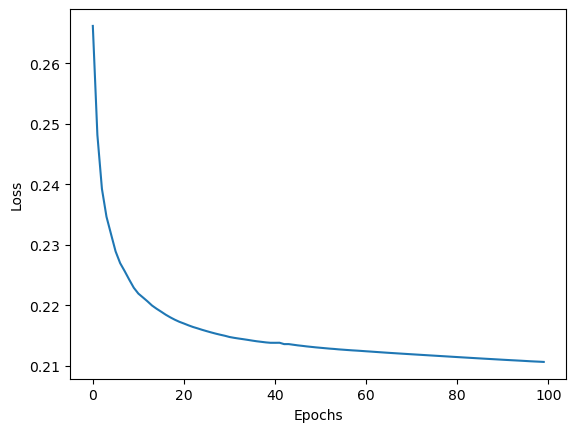

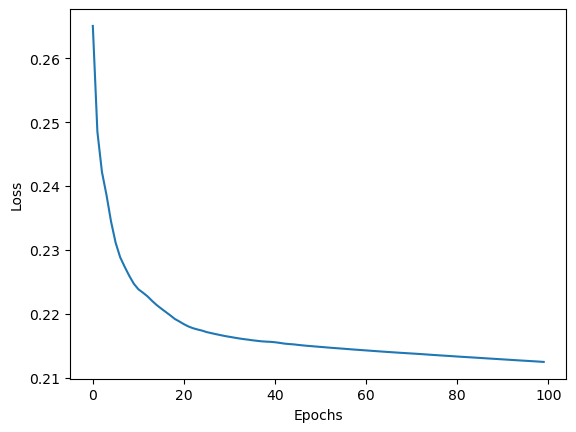

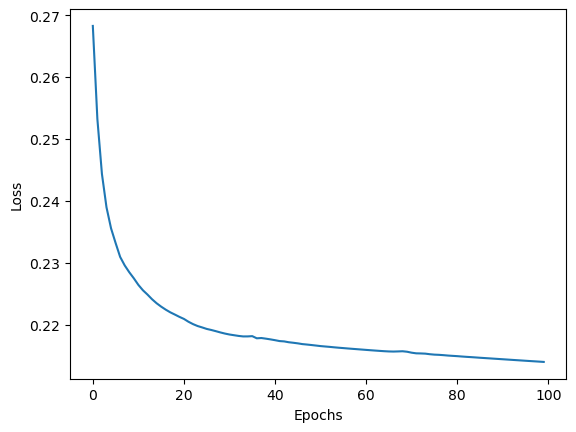

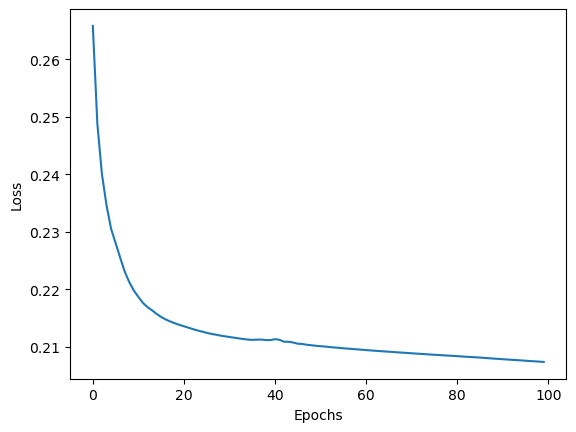

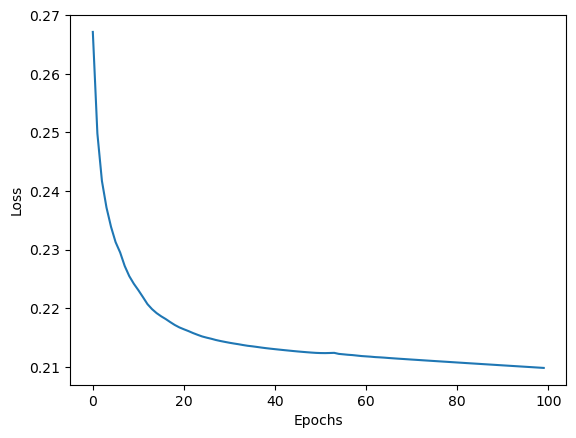

...

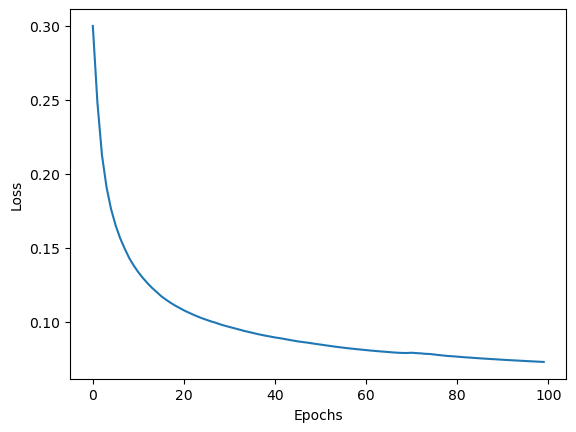

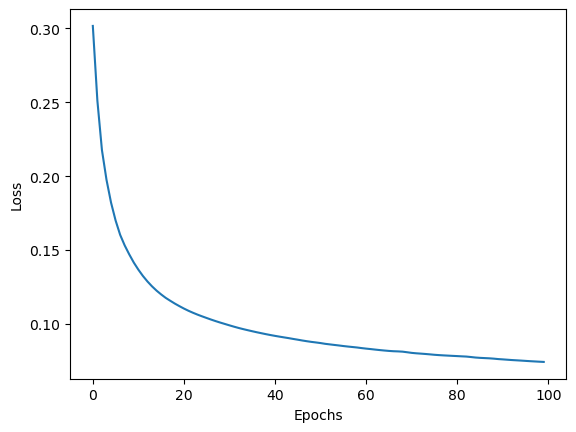

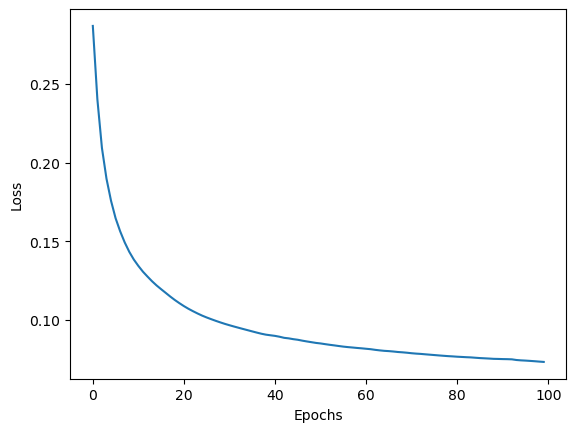

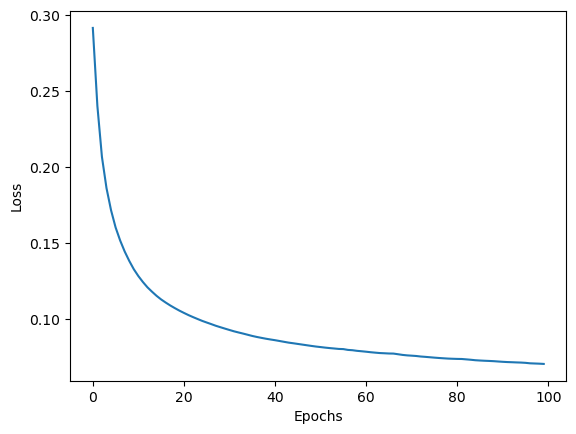

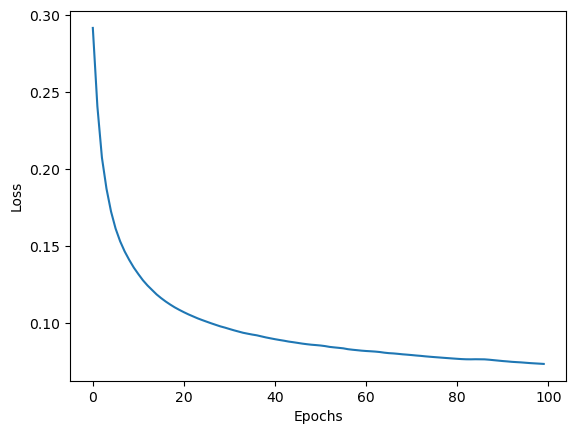

In [17]:
# %%--------------------------------------------------Initialization
nb_cc = [10, 20, 30, 50, 75]
ethnies = ["ch", "cau"]
prop = [0, 10, 20, 30, 40, 50]
epoques = 100

if not path.exists('ID_Results/results.csv'):
    with open('ID_Results/results.csv', mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['run', 'nb_cc','ethnie','proportion', 'name_train', 'correct'])
if not path.exists('ID_Results/summary.csv'):
    with open('ID_Results/summary.csv', mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['run', 'nb_cc', 'ethnie', 'proportion', 'proportion_correct_cau', 'proportion_correct_ch'])

for nb_cc_value in nb_cc:
    for ethnie in ethnies:
        for proportion in prop:
            for run in range(1,11):

                data, nb_reduit, nb_im = create_data('../STIM_NB_LumNorm/', ethnie, proportion)

                print('nb_cc: ',nb_cc_value, '; reduction :', proportion, '; ethnie : ', ethnie)

                #%%----------------------------------------Processing data
                pairs_train = data['Image'].to_list() # image sous forme de matrice
                lab_train = data['Label'].to_list()   # vecteur associé à l'image
                name_train = data['Nom'].to_list()  # nom de l'image
                        
                xtrain = np.array(pairs_train).reshape((nb_im, 300, 300, 1))
                ytrain = np.array(lab_train)
                x_train = data['Image'].values
                y_train = data['Label'].values

                #%%----------------------------------------TRAIN
                model = create_model(nb_cc_value) # create_conv(nb_cc_value)
                history = model.fit(xtrain, ytrain, epochs=epoques,batch_size=32, shuffle=False)

                #plot and save training curve
                history_model = history.history
                save_loss(history_model, epoques, nb_cc_value, ethnie, proportion)
                
                #%%----------------------------------------TEST
                prediction = model(xtrain).numpy()
                save_mean(ytrain, prediction, run, nb_cc_value, ethnie, proportion, name_train)
                save_score(prediction, ytrain, name_train, run, nb_cc_value, ethnie, proportion)

                del data, xtrain, ytrain, prediction, model, history
                gc.collect()
        prop.reverse()
        if 50 in prop:
            prop.remove(50)
        else:
            prop.append(50)

In [53]:
# Charger les données depuis le fichier CSV
data = pd.read_csv('ID_Results/donnees.csv', sep='\t')

# Sélectionner les colonnes 'proportion_correct_cau' et 'proportion_correct_ch'
columns_selected = data[['proportion_correct_cau', 'proportion_correct_ch']]

# Diviser les données en groupes de 10
groups = [columns_selected[i:i+10] for i in range(0, len(columns_selected), 10)]

# Calculer la moyenne de chaque groupe
group_means = [group.mean() for group in groups]

# Créer deux DataFrames pour les moyennes de chaque groupe
df_mean_ch = pd.DataFrame([mean['proportion_correct_ch'] for mean in group_means], columns=['mean_prop_ch'])
df_mean_cau = pd.DataFrame([mean['proportion_correct_cau'] for mean in group_means], columns=['mean_prop_cau'])

data_selected = data[::10].reset_index()

# Ajouter les colonnes de moyennes au DataFrame d'origine
data_with_means = pd.concat([data_selected[['nb_cc', 'ethnie', 'proportion']], df_mean_ch, df_mean_cau], axis=1)

# Afficher le DataFrame avec les colonnes de moyennes ajoutées
print(data_with_means)

    nb_cc ethnie  proportion  mean_prop_ch  mean_prop_cau
0      10     ch           0      0.000000       0.207143
1      10     ch          10      0.266667       0.208929
2      10     ch          20      0.407143       0.480357
3      10     ch          30      0.512500       0.503571
4      10     ch          40      0.470270       0.485714
5      10     ch          50      0.544643       0.517857
6      10    cau          40      0.475000       0.451351
7      10    cau          30      0.432143       0.508333
8      10    cau          20      0.469643       0.371429
9      10    cau          10      0.166071       0.333333
10     10    cau           0      0.187500       0.000000
11     20     ch           0      0.000000       0.410714
12     20     ch          10      0.350000       0.380357
13     20     ch          20      0.714286       0.705357
14     20     ch          30      0.829167       0.814286
15     20     ch          40      0.813514       0.791071
16     20     

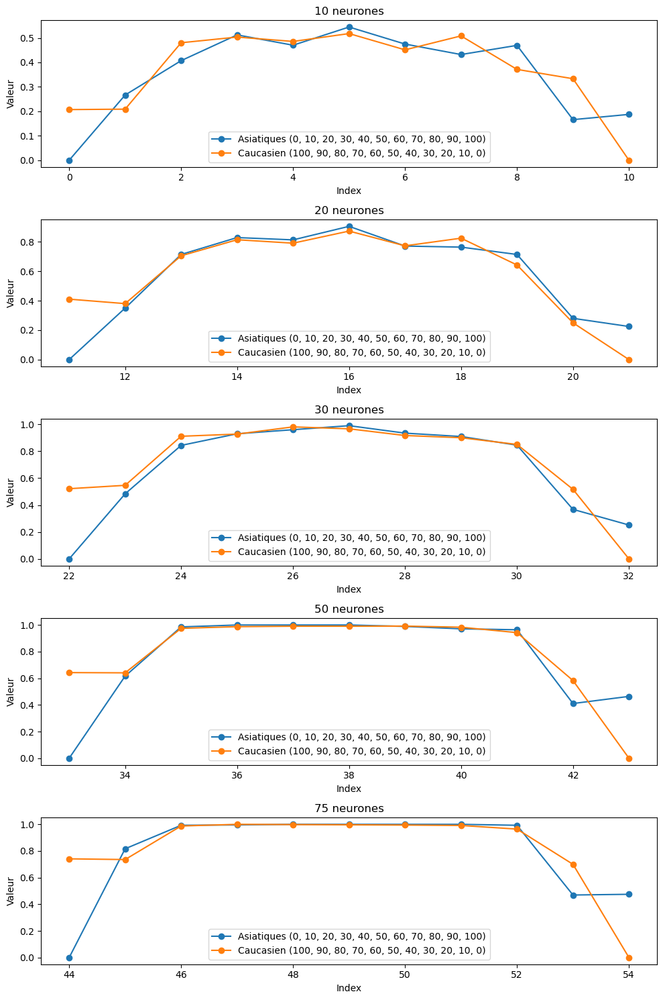

In [67]:
# Diviser les données en groupes de 11 lignes
groups = [data_with_means[i:i+11] for i in range(0, len(data_with_means), 11)]

# Créer 5 graphes
fig, axs = plt.subplots(5, figsize=(10, 15))

neurones = data_with_means['nb_cc'].unique()
# Afficher les 11 premières lignes de chaque groupe dans un graphe séparé
for i, group in enumerate(groups):
    ax = axs[i]
    ax.plot(group.index, group['mean_prop_ch'], marker='o', label='Asiatiques') 
    ax.plot(group.index, group['mean_prop_cau'], marker='o', label='Caucasien')
    ax.set_title(f'{neurones[i]} neurones')
    ax.set_xlabel('Index')
    ax.set_ylabel('Valeur')
    # Définir les étiquettes de la légende
    ax.legend(['Asiatiques (0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100)', 'Caucasien (100, 90, 80, 70, 60, 50, 40, 30, 20, 10, 0)'])


# Ajuster la disposition des graphes
plt.tight_layout()

# Afficher les graphes
plt.show()

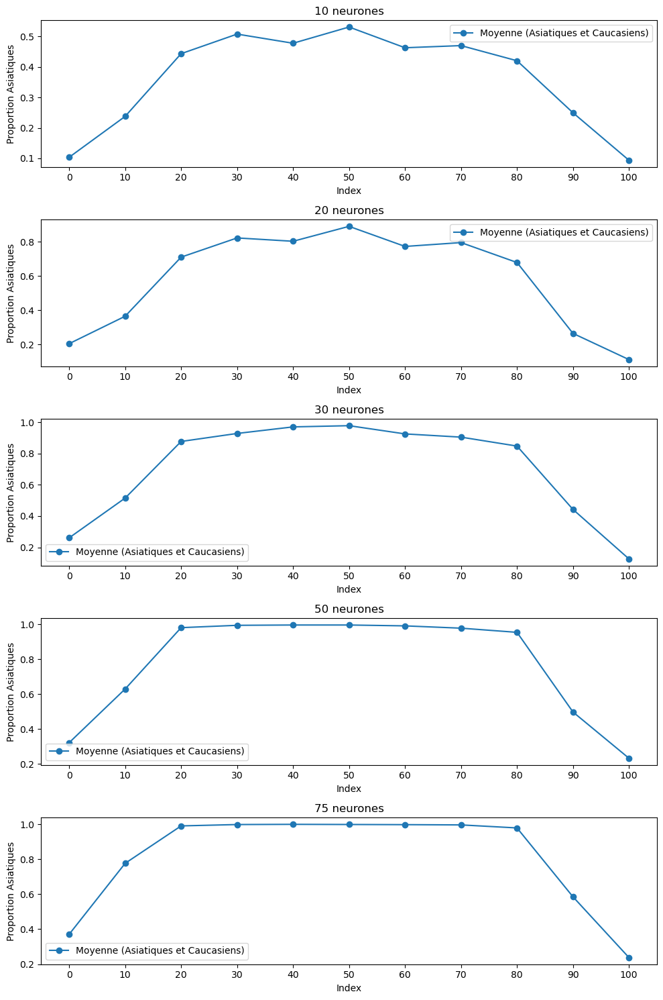

In [73]:
# Diviser les données en groupes de 11 lignes
groups = [data_with_means[i:i+11] for i in range(0, len(data_with_means), 11)]

# Créer 5 graphes
fig, axs = plt.subplots(5, figsize=(10, 15))

neurones = data_with_means['nb_cc'].unique()
# Afficher les 11 premières lignes de chaque groupe dans un graphe séparé
for i, group in enumerate(groups):
    ax = axs[i]
    
    mean_curve = (group['mean_prop_ch'] + group['mean_prop_cau']) / 2
    ax.plot(group.index, mean_curve, marker='o', label='Moyenne (Asiatiques et Caucasiens)')
    
    ax.set_title(f'{neurones[i]} neurones')
    ax.set_xlabel('Index')
    ax.set_xticks(group.index)
    ax.set_xticklabels(range(0, 110, 10))
    ax.set_ylabel('Proportion Asiatiques')
    # Définir les étiquettes de la légende
    ax.legend()


# Ajuster la disposition des graphes
plt.tight_layout()

# Afficher les graphes
plt.show()